In [34]:
import os
import pandas as pd
import ydata_profiling as pdp
import datetime
import numpy as np
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# 環境設定

In [9]:
DATA_PATH = "../data"

# 関数定義

In [39]:
def plot_histogram(df, column, title):
    fig = make_subplots(rows=1, cols=2)
    data_0 = df[df["MIS_Status"] == 0][column].copy()
    data_1 = df[df["MIS_Status"] == 1][column].copy()
    # ヒストグラム
    fig.add_trace(go.Histogram(x=data_0, histnorm='probability', opacity=0.5, name="不履行"), row=1, col=1)
    fig.add_trace(go.Histogram(x=data_1, histnorm='probability', opacity=0.5, name="完済"), row=1, col=1)
    # 箱ひげ図
    fig.add_trace(go.Box(y=data_0, name="不履行"), row=1, col=2)
    fig.add_trace(go.Box(y=data_1, name="完済"), row=1, col=2)
    # 集約統計量
    average_0 = data_0.mean()
    average_1 = data_1.mean()
    
    if title == None:
        title=column
    title += f"<br>不履行平均:{average_0} <br>完済平均: {average_1}"
    fig.update_layout(title=title, barmode='overlay')
    margin=dict(t=0, b=0, l=30, r=40)
    return fig

# 分析

## データ読み込み

In [11]:
train_data = pd.read_csv(os.path.join(DATA_PATH, "train.csv"), index_col=0)
test_data = pd.read_csv(os.path.join(DATA_PATH, "test.csv"), index_col=0)

## 前処理

In [12]:
dollar_amount_cols = ["DisbursementGross", "GrAppv", "SBA_Appv"]
for col in dollar_amount_cols:
    train_data[col] = train_data[col].apply(lambda x: x.replace("$", "").replace(".", "").replace(",", "")).astype(int).copy()
    test_data[col] = test_data[col].apply(lambda x: x.replace("$", "").replace(".", "").replace(",", "")).astype(int).copy()

## データ概要

In [13]:
print(f"学習データの行数・列数: {train_data.shape}")
print(f"テストデータの行数・列数: {test_data.shape}")

学習データの行数・列数: (42307, 20)
テストデータの行数・列数: (42308, 19)


In [14]:
train_data.dtypes

Term                   int64
NoEmp                  int64
NewExist             float64
CreateJob              int64
RetainedJob            int64
FranchiseCode          int64
RevLineCr             object
LowDoc                object
DisbursementDate      object
MIS_Status             int64
Sector                 int64
ApprovalDate          object
ApprovalFY             int64
City                  object
State                 object
BankState             object
DisbursementGross      int64
GrAppv                 int64
SBA_Appv               int64
UrbanRural             int64
dtype: object

In [15]:
train_data.columns[train_data.isnull().any()]

Index(['RevLineCr', 'LowDoc', 'DisbursementDate', 'BankState'], dtype='object')

In [11]:
profile = pdp.ProfileReport(train_data)
profile.to_file("myoutputfile.html")

Summarize dataset:   0%|                                  | 0/5 [00:00<?, ?it/s]/Users/ryusuke/anaconda3/envs/auto_edit/lib/python3.11/site-packages/ydata_profiling/model/typeset.py:208: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  is_valid_dtype = pdt.is_categorical_dtype(series) and not pdt.is_bool_dtype(
/Users/ryusuke/anaconda3/envs/auto_edit/lib/python3.11/site-packages/ydata_profiling/model/typeset.py:208: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  is_valid_dtype = pdt.is_categorical_dtype(series) and not pdt.is_bool_dtype(
/Users/ryusuke/anaconda3/envs/auto_edit/lib/python3.11/site-packages/ydata_profiling/model/typeset.py:125: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  not pdt.is_categorical

## データ詳細

### 日付関連

In [16]:
train_data[[
    "DisbursementDate", # 融資の支払日
    "ApprovalDate", # SBAの承認日
]].head()

,DisbursementDate,ApprovalDate
0,31-Jan-98,22-Sep-06
1,31-Oct-93,30-Jun-92
2,31-Aug-01,18-Apr-01
3,31-Aug-07,6-Oct-03
4,8-Jun-83,17-Dec-99


In [17]:
print(f'融資支払日が承認日よりも前：{train_data[train_data["DisbursementDate"] > train_data["ApprovalDate"]].shape[0]}')
print(f'承認日が融資支払日よりも前：{train_data[train_data["DisbursementDate"] < train_data["ApprovalDate"]].shape[0]}')

融資支払日が承認日よりも前：28008
承認日が融資支払日よりも前：14148


### 従業員数関連

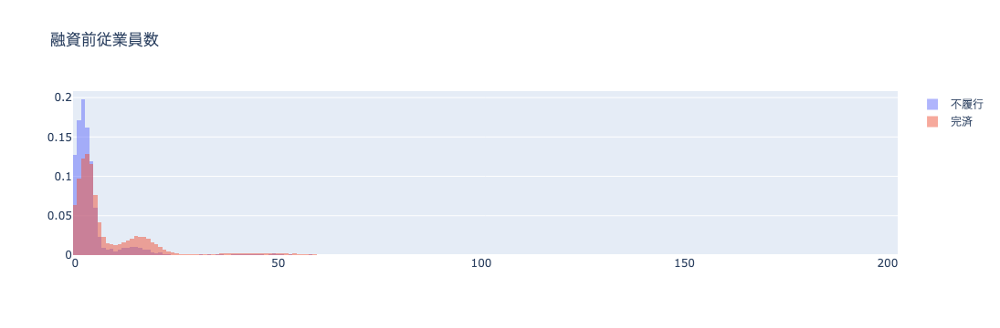

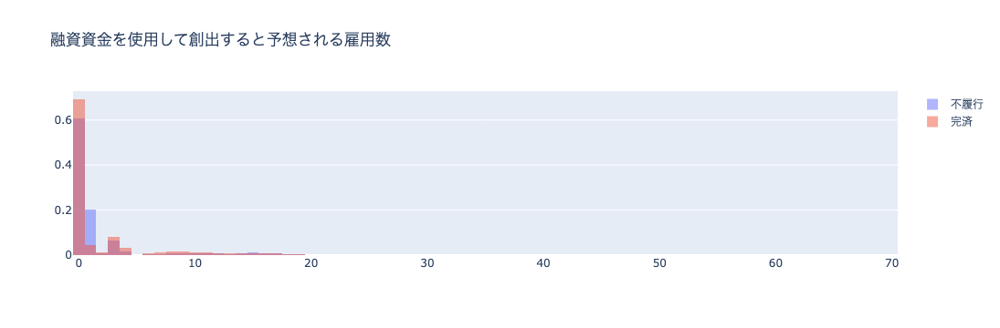

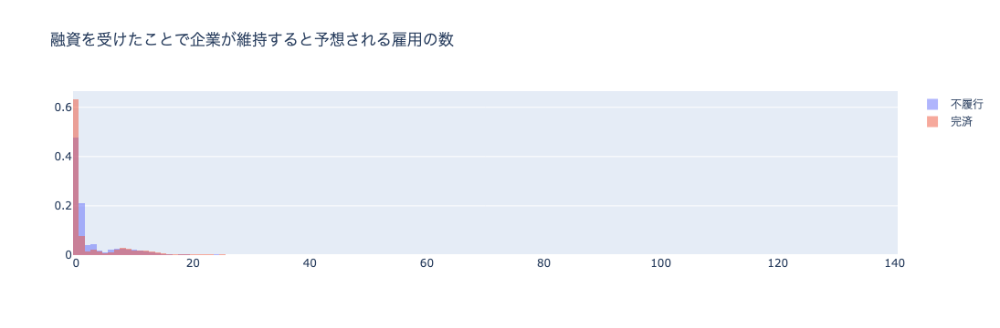

In [25]:
fig = plot_histogram(train_data, "NoEmp", title="融資前従業員数")
fig.show()
fig = plot_histogram(train_data, "CreateJob", title="融資資金を使用して創出すると予想される雇用数")
fig.show()
fig = plot_histogram(train_data, "RetainedJob", title="融資を受けたことで企業が維持すると予想される雇用の数")
fig.show()

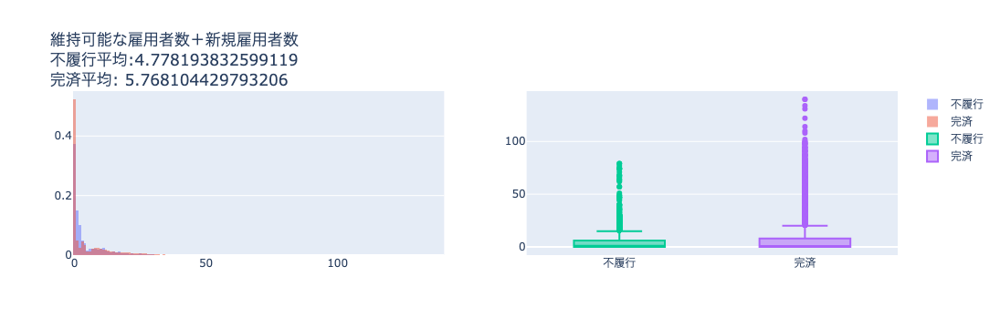

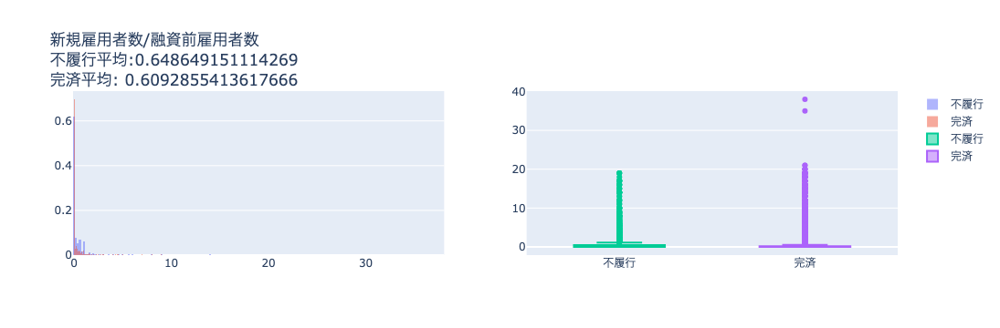

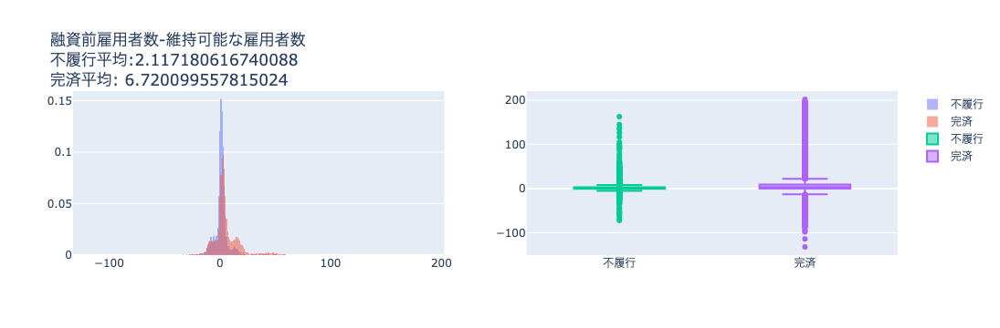

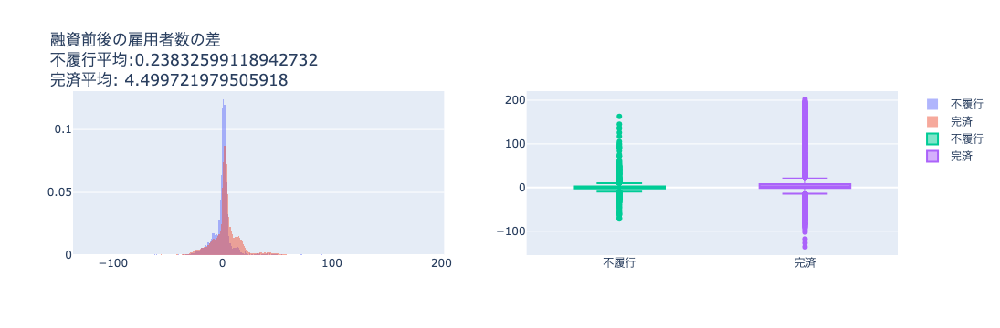

In [48]:
# 維持できる雇用者数と新規雇用者数の和
train_data["sumEmp"] = train_data["CreateJob"] + train_data["RetainedJob"]
fig = plot_histogram(train_data, "sumEmp", title="維持可能な雇用者数＋新規雇用者数")
fig.show()
# 融資前雇用者数に対する新規雇用者数の割合
train_data["CreateJobRatio"] = train_data["CreateJob"] / (train_data["NoEmp"]+1)
fig = plot_histogram(train_data, "CreateJobRatio", title="新規雇用者数/融資前雇用者数")
fig.show()
# 融資前雇用者数と維持できる雇用者数の差
train_data["emp_diff"] = train_data["NoEmp"] - train_data["RetainedJob"]
fig = plot_histogram(train_data, "emp_diff", title="融資前雇用者数-維持可能な雇用者数")
fig.show()
# 融資前後の雇用者数の差
train_data["emp_diff_ver2"] = train_data["NoEmp"] - (train_data["CreateJob"] + train_data["RetainedJob"])
fig = plot_histogram(train_data, "emp_diff_ver2", title="融資前後の雇用者数の差")
fig.show()

### 融資額・融資期間

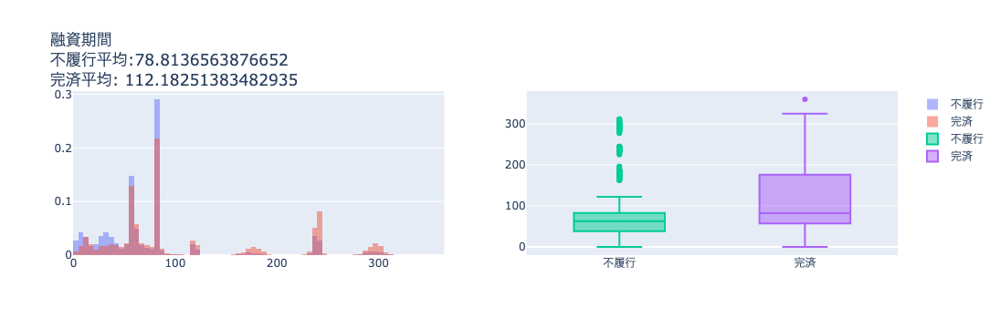

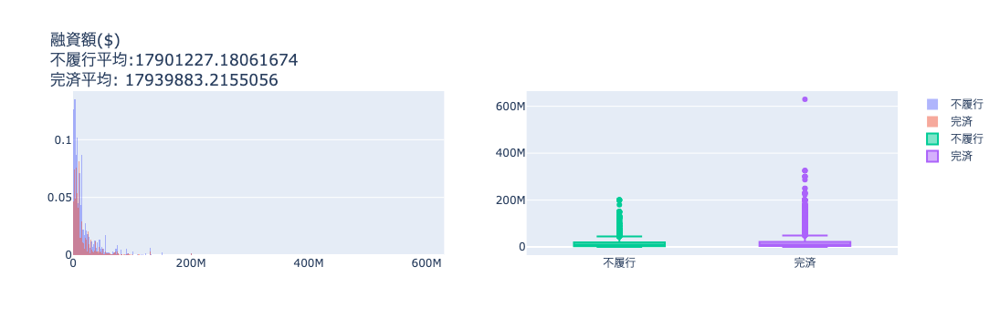

In [41]:
fig = plot_histogram(train_data, "Term", title="融資期間")
fig.show()
fig = plot_histogram(train_data, "DisbursementGross", title="融資額($)")
fig.show()

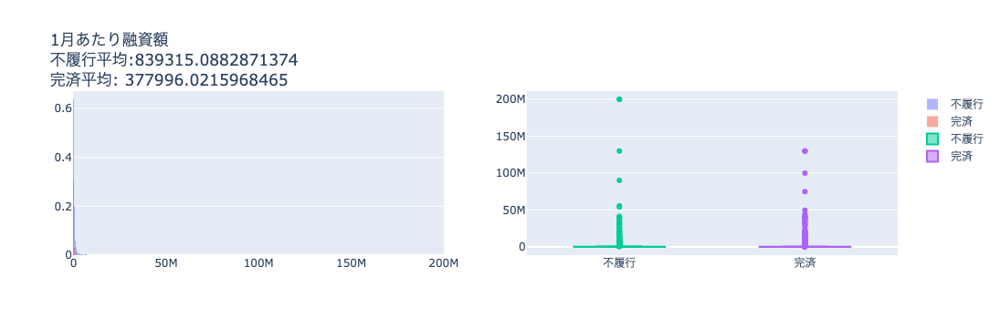

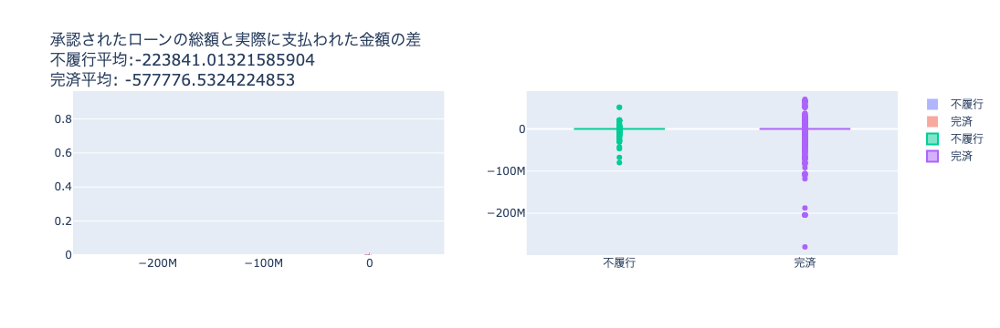

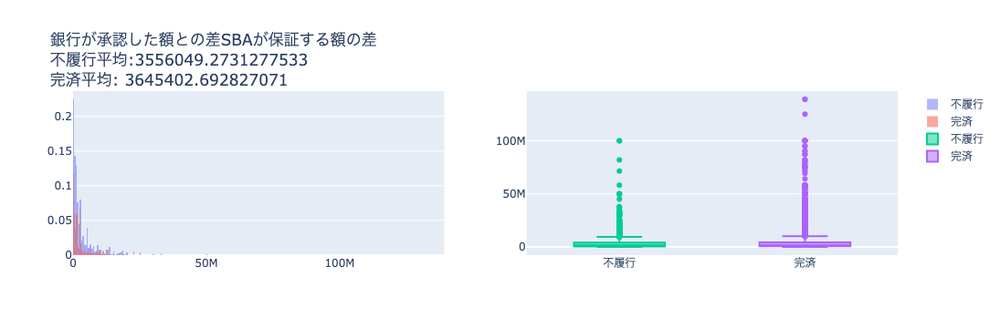

In [42]:
train_data["DisbursementGross_per_Month"] = train_data["DisbursementGross"] / (train_data["Term"]+1)
fig = plot_histogram(train_data, "DisbursementGross_per_Month", title="1月あたり融資額")
fig.show()

# 承認された額と支払われた額の差
train_data["AppvGrossDiff"] = train_data["GrAppv"] - train_data["DisbursementGross"]
fig = plot_histogram(train_data, "AppvGrossDiff", title="承認されたローンの総額と実際に支払われた金額の差")
fig.show()

# 銀行が承認した額との差SBAが保証する額の差
train_data["BankSBADiff"] = train_data["GrAppv"] - train_data["SBA_Appv"]
fig = plot_histogram(train_data, "BankSBADiff", title="銀行が承認した額との差SBAが保証する額の差")
fig.show()

### 列ごとのnullの数

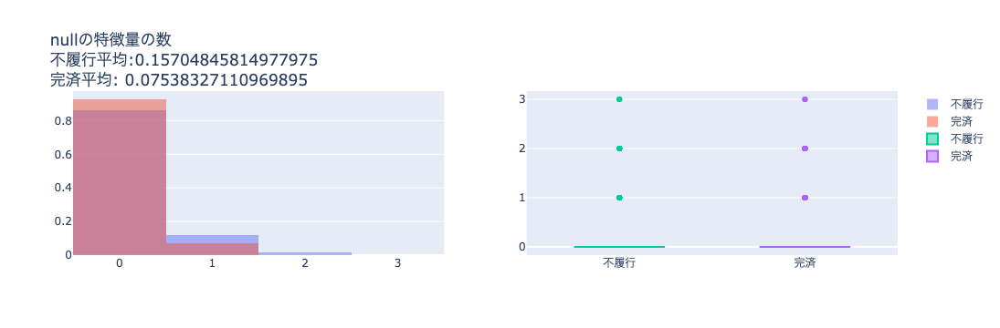

In [45]:
train_data["null_cnt"] = train_data.isnull().sum(axis=1)
fig = plot_histogram(train_data, "null_cnt", title="nullの特徴量の数")
fig.show()